In [1]:
from IPython.display import HTML
HTML('''
<script>
code_show=false;
function code_toggle(){
    if(code_show){$('.prompt, .input, .output_stderr, .output_error').hide();}
    else{$('.input, .prompt, .output_stderr, .output_error').show();}
    code_show=!code_show;
}
function initialize(){
document.body.style.fontFamily='Palatino';
    var output=$('.output_subarea.output_text.output_stream.output_stdout');
    $.merge(output,$('.output_subarea.output_text.output_result'));
    for(var i=0;i<output.length;i++)for(var j=0;j<output[i].children.length;j++)
        output[i].children[j].style.fontFamily='Palatino';
    code_toggle();
}
$(document).ready(initialize);
</script>
Click <a href="javascript:code_toggle()">here</a> to show/hide codes in this notebook.
''')
#https://allenfrostline.com/blog/hide-code-jupyter/

# 2-Section (Gain+DBR) Laser Demux Controller AI

### Visualizing the raw data
Displaying the original collected raw data, we have 2-dimensional "tuning maps" that show the relationship from the DBR and Gain section bias current input variables, to the optical wavelength, SMSR, and power output variables. These are displayed below:


#### Wavelength Tuning Maps
<table><tr><td><img src='./maps/wave/ABwave.jpg'></td><td><img src='./maps/wave/EFwave.jpg'></td><td><img src='./maps/wave/GHwave.jpg'></td></tr></table>

#### Power Tuning Maps
<table><tr><td><img src='./maps/power/ABpower.jpg'></td><td><img src='./maps/power/EFpower.jpg'></td><td><img src='./maps/power/GHpower.jpg'></td></tr></table>


#### SMSR Tuning Maps
<table><tr><td><img src='./maps/smsr/ABsmsr.jpg'></td><td><img src='./maps/smsr/EFsmsr.jpg'></td><td><img src='./maps/smsr/GHsmsr.jpg'></td></tr></table>

To algorithmically control and callibrate the Demux, an invertible mapping of the electric current inputs to optical wavelength output can be a useful representation by:
* modelling device with a forward function of electic inputs to optical outputs
* allowing an external entity (a user, or higher-level algorithm) to select a desired output, and being able to produce the required corresponding inputs to yield that output on the physical device

Additionaly, since many electrical current operating points can correspond to the same optical wavelength output, SMSR and power constraints or thresholds must be used to determine a strong operating point that can transmit a signal sufficiently. This processing of data can be used as a final decision layer after the inverted function model to decide whether an operating point is sufficient, or whether a better one is required. 
# -------------------------------------------------------------------------------------------------------------------------
    

In [2]:
# run this cell first to import the libraries used in the code
import numpy as np
from matplotlib import pyplot as plt
import plotly.express as px
import tensorflow as tf
import glob
import pandas as pd
import csv
import os
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn import metrics
from plotly.subplots import make_subplots
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import time
from sklearn.cluster import DBSCAN, OPTICS
from scipy import stats, interpolate, optimize

In [3]:
from keras.models import Sequential
from keras.layers import Dense, Dropout
from keras.wrappers.scikit_learn import KerasClassifier
from sklearn.model_selection import cross_val_score, cross_val_predict
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import StratifiedKFold
from sklearn.pipeline import Pipeline

Using TensorFlow backend.


In [4]:
# directory locations and files of the tuning map data
files_wave = "./maps/wave/*.csv"
dir_wave = "./maps/wave"

files_power = "./maps/power/*.csv"
dir_power = "./maps/power"

files_smsr = "./maps/smsr/*.csv"
dir_smsr = "./maps/smsr"


# function that imports tuning map data into python program
def getMaps(dirc,files):
    train_maps = np.array([list(csv.reader(open(maps))) for maps in glob.glob(files)])
    filenames = os.listdir(dirc)
    return train_maps , filenames

# use the previous function to import wavlength, power, and smsr, tuning maps as well as the names of each map file
wave_maps, wave_files  = getMaps(dir_wave,files_wave)
smsr_maps, smsr_files = getMaps(dir_smsr, files_smsr)
pow_maps, pow_files = getMaps(dir_power,files_power)

#arrange the tuning maps into python dictionary
AB = np.float32(np.array([wave_maps[0], smsr_maps[0], pow_maps[0]]))
EF = np.float32(np.array([wave_maps[1], smsr_maps[1], pow_maps[1]]))
GH = np.float32(np.array([wave_maps[2], smsr_maps[2], pow_maps[2]]))
DEMUXES, COLS, ROWS = AB.shape

### Re-Visualizing the wavelength maps

We can "flatten" the wavelength tuning maps by enumerating through each plotted point on the tuning map and plotting the wavelength on the y-axis to get a 1-dimensional representation of the initial data. (Note that in this notebook the range of the DBR used is [40mA, 70mA], so all the maps can be treated as being the same size in the following code)

Denoting operating points as (DBR, GAIN) with the electrical current into each section, we can show the mapping in a table below:

|(DBR, GAIN) [mA] | X |  Y [nm]  |
|--- | --- | --- |
(40, 40) | 0 | 1547.03
(40, 42) | 1 | 1547.28
(40, 44) | 2 | 1547.69
...|...|...
...|...|...
(42, 40)| 56 | 1547.71
(42, 42)| 57 | 1547.27
(42, 44)| 58 | 1547.68
...|...|...
...|...|...
(70, 146)| 1174  | 1549.91
(70, 148)| 1175  | 1549.91

Re-plotting the wavelength tuning maps for each demux channel gives:

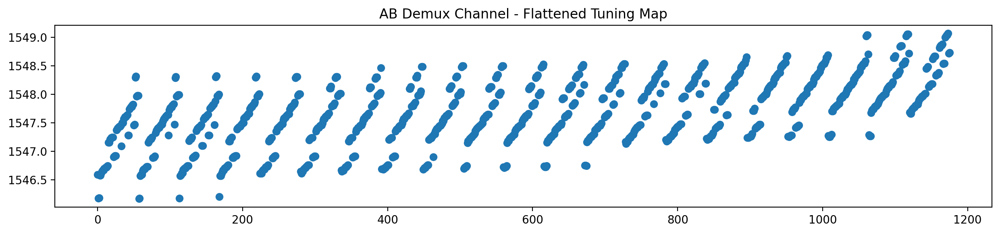

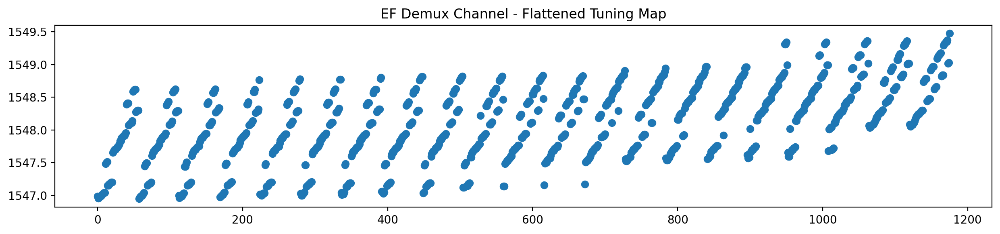

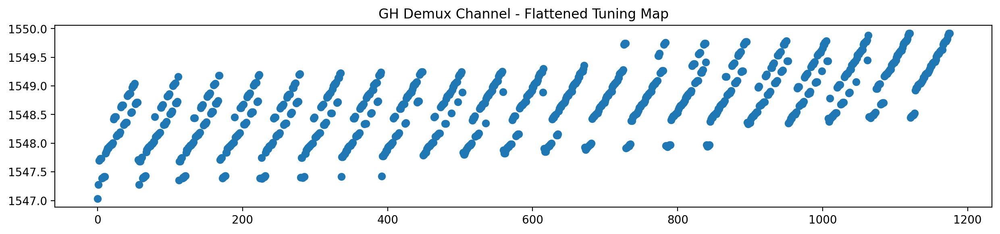

In [5]:
plt.rcParams.update({'figure.figsize':(15,3), 'figure.dpi':200})
ENUMERATED_X_AXIS = np.arange(ROWS*COLS)

plt.title("AB Demux Channel - Flattened Tuning Map")
plt.scatter(x = ENUMERATED_X_AXIS, y= AB[0].flatten())
plt.show()

plt.title("EF Demux Channel - Flattened Tuning Map")
plt.scatter(x = ENUMERATED_X_AXIS, y= EF[0].flatten())
plt.show()

plt.title("GH Demux Channel - Flattened Tuning Map")
plt.scatter(x = ENUMERATED_X_AXIS, y= GH[0].flatten())
plt.show()

In the resulting plots we can easily visualize the 21 columns from the tuning maps as 21 linear-like regions in the flattened data.

### Linear Regressions of Data Columns from Flattened Wavelength Tuning Maps

We can compute a linear regression of each column to model the raw data. A linear representation benefits from being easily invertible, as well as quickly computable in both forward and inverse directions. If we represent each column with one slope value and one y-intercept value, we simply need to store 2 x 21 = 42 data entries, as opposed to the whole initial 1176-point dataset.

The regressions of each column from the wavelength tuning maps are calculated and plotted below with the original data:

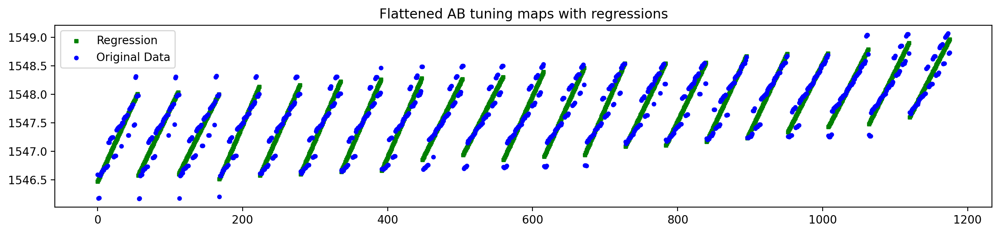

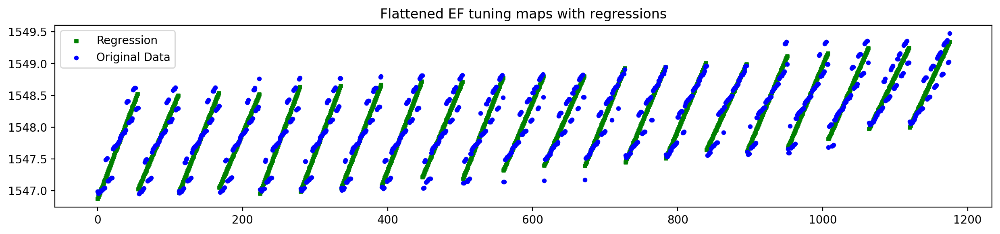

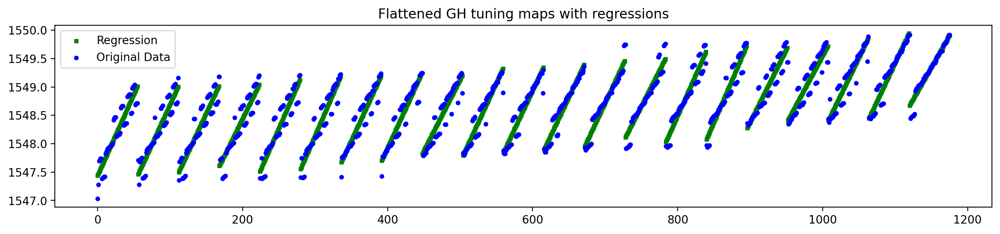

In [6]:
def simpleColumnRegressions(wavemaps):    
    regr_lines = np.zeros((COLS,6))
    for column in range(COLS):
        regr_x = np.arange(column*ROWS,column*ROWS+ROWS)    
        slope, intercept, r, p, std_err = stats.linregress(regr_x, wavemaps[0,column])
        
        regr_lines[column] = [slope,intercept,r,p,std_err,column]
    
    regr_out = np.zeros((COLS,ROWS))
    for column in range(COLS):
        regr_out[column] = np.arange(56*column,56*column+56)*regr_lines[column,0]+regr_lines[column,1]
    regr_out = regr_out.reshape((COLS*ROWS)) 
    
    #plot the regressions on top of the raw data
    fig = plt.figure()
    ax1 = fig.add_subplot(111)
    
    if((wavemaps == AB).all()):
        title = 'AB'
    elif((wavemaps == EF).all()):
        title = 'EF'
    elif((wavemaps == GH).all()):
        title = 'GH'
    ax1.title.set_text('Flattened '+title+' tuning maps with regressions')
    
    ax1.scatter(np.arange(21*56), regr_out, s=10, c='g', marker="s", label='Regression')
    ax1.scatter(np.arange(21*56), wavemaps[0].flatten(), s=10, c='b', marker="o", label='Original Data')
    plt.legend(loc='upper left');
    plt.show()
    
    error = regr_lines[:,4]
    return regr_out, error

regr_AB, err_AB = simpleColumnRegressions(AB)
regr_EF, err_EF = simpleColumnRegressions(EF)    
regr_GH, err_GH = simpleColumnRegressions(GH)

#print(np.mean(err_AB))
#print(np.mean(err_EF))
#print(np.mean(err_GH))


To get a quick evaluation of the accuracy of each of the 3 models, we take the mean of the standard error across the 21 regressions for each of the 3 demux channels:

* Std_err_AB = 0.001414
* Std_err_EF = 0.001418
* Std_err_GH = 0.001482

The standard error values reveal that the average observed error in optical wavelength from using this model is approximately 0.0014nm.

If we zoom in on data from one column and its corresponding regression we can investigate the robustness of this model:





In [7]:
fig = make_subplots()
fig.add_trace(go.Scatter(x=np.arange(ROWS), y=regr_AB[:ROWS]))
fig.add_trace(go.Scatter(x=np.arange(ROWS), y=AB[0,0], mode = 'markers+text'))
fig.show()

Upon inspection it is apparent that the data may be modelled more accurately as multiple short linear-like segments, as opposed to one whole linear region. The earlier model is flawed in that it is rotated slightly towards the +y-axis from the raw data. Each short linear segment has less steep of a slope than the single regression that is calculated for the whole data column, this increased steepness of the regression comes from the multiple linear segments being vertically shifted from each other, corresponding to the segments having equal slopes, but different y-intercept values. 


### An improved regression model of multiple linear regions

We can develop a model more robust by performing regressions on the smaller linear-like regions. Shown below are these computed regressions, there are 21 plots created for each of the 3 different demux channels:

In [8]:
class DemuxRegressor:
    
    def __init__(self, demux = None, tuningMapColumn = None, labels = None):
        self.demux = demux
        self.tuningMapColumn = tuningMapColumn  
        self.labels = labels
    
    def setDemux(self, demuxChannel):        
        if(demuxChannel.lower() == 'ab'):
            self.demux = AB
        elif(demuxChannel.lower() =='ef'):
            self.demux = EF
        elif(demuxChannel.lower() =='gh'):
            self.demux = GH            
        return
    
    def setDBRcurrent(self, DBRcurrent):
        index = int((DBRcurrent - 40)/2)
        column = self.demux[0,index]
        index_range = (column.shape[0])
        
        
        if((index>index_range)):
            print("Current out of range")
            return
        else:
            self.tuningMapColumn = self.demux[0,index]
        return
    
    def DBSCANofCol(self, EPS = 0.05, MINSAMPLES = 1, showPlots = True):        
        wavelength = np.float32(self.tuningMapColumn)
        
        db_default = DBSCAN(eps =EPS , min_samples = MINSAMPLES, algorithm = 'auto', p = 2).fit(np.array(wavelength).reshape((-1,1)))
        labels = db_default.labels_
        self.labels = labels
        
        check = np.zeros((wavelength.shape[0],2))
        check[:,0] = np.array(wavelength) 
        check[:,1] = np.array(labels)
        df = pd.DataFrame(check)
        df.columns = ['wavelength', 'label']
        if(showPlots):
            fig = px.scatter(df, x=np.arange(wavelength.shape[0]), y='wavelength', color = 'label')
            fig.show()
        
        return labels
    
    def getSlopes(self, EPS = 0.05, MINSAMPLES = 1, showPlots = True):
        wavelengths = self.tuningMapColumn  
        labels = self.DBSCANofCol(EPS, MINSAMPLES, showPlots)
        slopes = []
        intercepts = []
        regr_lines = {}
        num_regrs = 0
    
        i = 0
        while(i < wavelengths.shape[0]):
     
            inCluster = 0
        
            for j in range(i+1, wavelengths.shape[0]):
  
           
                if(labels[i] == labels[j]):
                    inCluster += 1
                
                    if(j == (wavelengths.shape[0]-1)):
                        local_cluster = wavelengths[i:j+1] 
                        slope, intercept, r, p, std_err = stats.linregress(np.arange(i,j+1), local_cluster)
                        regr_lines[num_regrs,0] = slope
                        regr_lines[num_regrs,1] = intercept
                        regr_lines[num_regrs,2] = r
                        regr_lines[num_regrs,3] = p
                        regr_lines[num_regrs,4] = std_err 
                        regr_lines[num_regrs,5] = i
                        regr_lines[num_regrs,6] = j
                
                        slopes.append([slope])
                        intercepts.append([intercept])
                        num_regrs+=1
                
                        break
                    
                
                elif(inCluster > 0):
                    local_cluster = wavelengths[i:j] 
                    slope, intercept, r, p, std_err = stats.linregress(np.arange(i,j), local_cluster)
                    regr_lines[num_regrs,0] = slope
                    regr_lines[num_regrs,1] = intercept
                    regr_lines[num_regrs,2] = r
                    regr_lines[num_regrs,3] = p
                    regr_lines[num_regrs,4] = std_err 
                    regr_lines[num_regrs,5] = i
                    regr_lines[num_regrs,6] = j
                
                    slopes.append([slope])
                    intercepts.append([intercept])
                    num_regrs+=1
                
                    break
                elif((labels[i]!=labels[j]) and (inCluster == 0)):
                    break
                
            i += inCluster + 1
        slopes = np.array(slopes)
        intercepts = np.array(intercepts)
        return regr_lines, slopes, intercepts  

    def plotRegressions(self, EPS = 0.05, MINSAMPLES = 1, showPlots = True):
        wavelength = np.float32(self.tuningMapColumn)
        regr , m, b = self.getSlopes(EPS, MINSAMPLES, showPlots)
        labels = self.labels
        ranges = np.zeros((m.shape[0], 2))

        for i in range(m.shape[0]):
            ranges[i,0] = regr[i,5] 
            ranges[i,1] = regr[i,6]

        IN = {}
        OUT = {}
    
        for i in range(m.shape[0]):
        
            IN[i] =np.arange(ranges[i,0], ranges[i,1])
            OUT[i] = IN[i]*m[i] + b[i]
        
            if(i == (m.shape[0]-1)):
                IN[i] =np.arange(ranges[i,0], ranges[i,1]+1)
                OUT[i] = IN[i]*m[i] + b[i]

        if(showPlots == True):
            fig = make_subplots()


            for i in range(len(IN.keys())):
                fig.add_trace(go.Scatter(x=IN[i], y=OUT[i], mode = 'lines')) 


            fig.add_trace(go.Scatter(x=np.arange(wavelength.shape[0]), y=wavelength, mode = 'markers+text'))
            fig.show()  
        
        return IN, OUT, ranges
    
    def colLogRegression(self):
        outX = np.array([])
        outY = np.array([])
        power = self.demux[2]
        
        for i in range(power.shape[0]):
        
            x = np.arange(1 + 56*i, 57 + 56*i)
            fit = np.polyfit(np.log(x), power[i], 1)
        
            x_reg = np.arange(1 + 56*i, 57 + 56*i, 0.01)
            y_reg = np.log(x_reg)*fit[0] +fit[1]
        


        


        
        

In [9]:
#test cell to test class implementation of regressor object
x = DemuxRegressor()
x.setDemux('ab')
x.setDBRcurrent(56)
X, Y, ranges = x.plotRegressions(showPlots = False)

print(AB[2].shape)


(21, 56)


In [10]:
def allColsRegress(demuxChannel = 'ab'):
    x = DemuxRegressor()
    x.setDemux(demuxChannel)
    ins = {}
    outs = {}
    for i in range(21):
        dbr = 40+(i*2)
        x.setDBRcurrent(dbr)
        ins[i], outs[i], ranges = x.plotRegressions(showPlots = False)
    return ins, outs       

In [11]:
def regressionsToSingleArray(demuxChannel = 'ab'):
    ins, outs = allColsRegress(demuxChannel)
    Y = []
    X = []
    for i in range(len(outs.keys())):
        for j in range(len(outs[i].keys())):
            for k in range(len(outs[i][j])):
                Y.append(outs[i][j][k])
                X.append(ins[i][j][k])
    return Y, X 

In [12]:
REG_X = {}
REG_Y = {}

ins, outs = allColsRegress()
x.setDemux('ab')
REG_X[0], REG_Y[0] = ins, outs
ROW = 1
fig = make_subplots(rows = 7, cols = 3, shared_yaxes = True, horizontal_spacing = 0.01, vertical_spacing = 0.02)
for i in range(len(ins.keys())):
    if(i==7 or i==14):
        ROW += 1
    for j in range(len(ins[i].keys())):

        fig.add_trace(go.Scatter(x=ins[i][j], y=outs[i][j], mode = 'lines'), row = (i%7)+1, col = ROW)
        
        x.setDBRcurrent((i*2)+40)
        
    fig.add_trace(go.Scatter(x=np.arange(x.tuningMapColumn.shape[0]), y=x.tuningMapColumn, mode = 'markers+text', marker=dict(color = 'black', size=np.full(x.tuningMapColumn.shape[0],3))), row = (i%7)+1, col = ROW)
        
fig.update_layout(height=1000, width=1000, title_text="AB Tuning Map Raw Data w/ Improved Regressions")
fig.show()

In [13]:
ins, outs = allColsRegress('ef')
x.setDemux('ef')
REG_X[1], REG_Y[1] = ins, outs
ROW = 1
fig = make_subplots(rows = 7, cols = 3, shared_yaxes = True, horizontal_spacing = 0.01, vertical_spacing = 0.02)
for i in range(len(ins.keys())):

    if(i==7 or i==14):
        ROW += 1
    for j in range(len(ins[i].keys())):


        fig.add_trace(go.Scatter(x=ins[i][j], y=outs[i][j], mode = 'lines'), row = (i%7)+1, col = ROW)
        
        x.setDBRcurrent((i*2)+40)
        
    fig.add_trace(go.Scatter(x=np.arange(x.tuningMapColumn.shape[0]), y=x.tuningMapColumn, mode = 'markers+text', marker=dict(color = 'black', size=np.full(x.tuningMapColumn.shape[0],3))), row = (i%7)+1, col = ROW)
        
fig.update_layout(height=1000, width=1000, title_text="EF Tuning Map Raw Data w/ Improved Regressions")
fig.show()

In [14]:
ins, outs = allColsRegress('gh')
x.setDemux('gh')
ROW = 1
REG_X[2], REG_Y[2] = ins, outs
fig = make_subplots(rows = 7, cols = 3, shared_yaxes = True, horizontal_spacing = 0.01, vertical_spacing = 0.02)
for i in range(len(ins.keys())):

    if(i==7 or i==14):
        ROW += 1
    for j in range(len(ins[i].keys())):


        fig.add_trace(go.Scatter(x=ins[i][j], y=outs[i][j], mode = 'lines'), row = (i%7)+1, col = ROW)
        
        x.setDBRcurrent((i*2)+40)
        
    fig.add_trace(go.Scatter(x=np.arange(x.tuningMapColumn.shape[0]), y=x.tuningMapColumn, mode = 'markers+text', marker=dict(color = 'black', size=np.full(x.tuningMapColumn.shape[0],3))), row = (i%7)+1, col = ROW)
        
fig.update_layout(height=1000, width=1000, title_text="GH Tuning Map Raw Data w/ Improved Regressions")
fig.show()

## Algorithm Outline

Detecting the multiple regression lines is accomplished by using an optimal clustering algorithm to label the data points from each tuning map column according to the degree of relationship between its neighbouring data points;. A linear regression is then performed on each cluster to obtain the final regression model.

### 1. Clustering

DBSCAN clustering from the sci-kit learn library is used to label the data. This clustering algorithm is robust to linear-shaped clusters that are adjacent to each other, (Source: https://scikit-learn.org/stable/modules/clustering.html) and can intuitively cluster the flattened the tuning map data. Many clustering algorithms would cluster adjacent clusters of this shape incorrectly by crossing over into adgacent lines, or clustering multiple lines into the a big erroneous cluster. Varying the min_samples and eps hyperparameters of the algorithm can also yield multiple different intuitive cluster schemes for the data. The ranges of testing can be shown for each hyperparameter:

|eps = | [0.05, 0.10, 0.15] |
| --- | --- |

|min_samples = | [1,2,3,4,5] |
| --- | --- |

The optimal hyperparameter configuration chosen here uses eps = 0.05 and min_samples = 1. The clustering is thus determined by a small error margin between neighbouring points, while also requiring a cluster to include only 2 neighbouring points. This allows clusters to be seperated from each other even if the error between two elements is very small, and allows regression of multiple highly linearly correlated clusters. 

### 2. Linear Regressions

Each seperate cluster is modelled with a linear regression who's domain extends only from the starting element to the final element of each cluster. This can be thought of as a piece-wise discontinous linear function that maps the indexed current values to the range of output wavelength values. The linear nature of this function benefits from the fact that it creates an invertible mapping between the inputs and the outputs. 

## An Intelligent Laser Transmitter Controller

The archtecture of a laser transmitter requires controlling the wavelength and SMSR output by the laser source. In order to do this a controller must manually search through bias current input configurations in order to find a configuration that yields the desired output. This manual search must be computed either by directly changing the input currents until the correct output is produced, or performing a database search of experimentally collected data that samples the laser output values for each input value. Both search procedures are limited by resolution of the data, as well the computational complexity of searching through the domain of input variables. For a laser with multiple active sections this search becomes exponentially more expensive for each additional section that requires its own input current. 

To create a minimal model of the laser we can choose a minimum number of regression columns that cover the whole range of outputs. Each column has its own set of lines that represent its regression. The weight, bias, error, and endpoints of each piecewise component is calculated and stored. To operate the device at some given optical wavelength A, an algorithm must be defined to calculate the bias current inputs that will yield an optical output with minimal error. We can define this algorithm as an optimization problem where we want to find a value x* that yields f(x*) = A which can be computed by performing optimization via Newton's method or gradient descent on the equation f(x*) - A = 0.

Implementing this with the set of all regressions to find a x* that yields f(x*) = A for a given A:

1. Shift down each line by A
2. For each piecewise segment, multiply the y-axis endpoint values together (resulting in one product per piecewise segment)
3. Search through each value calculated in the previous step until a negative product value is found (a line that crosses the x-axis)
4. Use the slope (m) and y-intercept (b) values for that line to calculate: x* = (A - b)/m (derived from y = mx* + b - A )

Now that the required input x* is calculated, we can map the index back to the two electrical bias currents that will output a guess A* that the model calculates as having the minimum amount of error from A. 

To calculate the optical power output, logarithmic regressions are computed for each column of th tuning maps using the experimental power output data. After a bias current configuration is found, we can calculate an estimate of what the optical output power will be and determine if the power is high enough above a specified threshold to decide whether an operating point is valid. To take further advantage of the logarithmic distribution of the power output data, the data points below a specified threshold can be discarded to further minimize the size of the model; however this presents the cost of not being able operate at lower output wavelength values that get cut off. An improved selection criteria can use both the output power and the output SMSR to determine whether a given bias current configuration should be selected as an operating point.


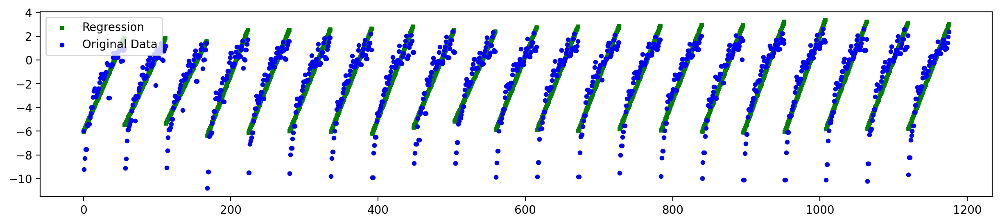

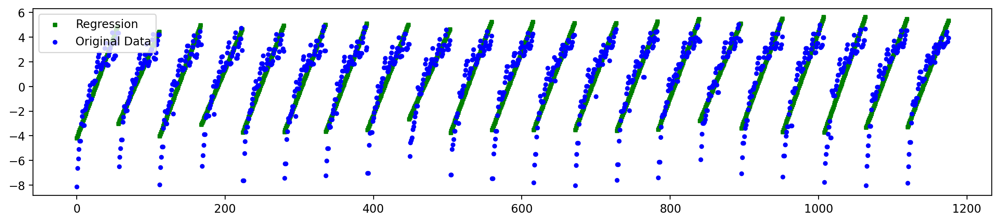

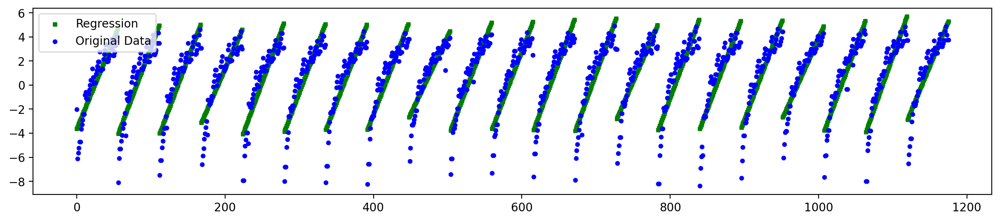

In [15]:
def simpleColumnRegressions(wavemaps):    
    regr_lines = np.zeros((3,21,6))
    for i in range(DEMUXES):
        for j in range(COLS):
            regr_x = np.arange(j*56,j*56+56)    

            slope, intercept, r, p, std_err = stats.linregress(regr_x, wavemaps[i,j])
            regr_lines[i,j] = [slope,intercept,r,p,std_err,j]
            #print(std_err)
    regr_out = np.zeros((3,21,56))
    for i in range(DEMUXES):
        for j in range(COLS):
            regr_out[i,j] = np.arange(56*j,56*j+56)*regr_lines[i,j,0]+regr_lines[i,j,1]
    regr_out = regr_out.reshape((3,21*56)) 
    return regr_out, regr_lines

regr_AB, regr_AB_params = simpleColumnRegressions(AB)
regr_EF, regr_EF_params = simpleColumnRegressions(EF)    
regr_GH, regr_GH_params = simpleColumnRegressions(GH)  

fig = plt.figure()
ax1 = fig.add_subplot(111)
ax1.scatter(np.arange(21*56), regr_AB[2], s=10, c='g', marker="s", label='Regression')
ax1.scatter(np.arange(21*56), AB[2].flatten(), s=10, c='b', marker="o", label='Original Data')
plt.legend(loc='upper left');
plt.show()

fig = plt.figure()
ax1 = fig.add_subplot(111)
ax1.scatter(np.arange(21*56), regr_EF[2], s=10, c='g', marker="s", label='Regression')
ax1.scatter(np.arange(21*56), EF[2].flatten(), s=10, c='b', marker="o", label='Original Data')
plt.legend(loc='upper left');
plt.show()

fig = plt.figure()
ax1 = fig.add_subplot(111)
ax1.scatter(np.arange(21*56), regr_GH[2], s=10, c='g', marker="s", label='Regression')
ax1.scatter(np.arange(21*56), GH[2].flatten(), s=10, c='b', marker="o", label='Original Data')
plt.legend(loc='upper left');
plt.show()



In [16]:
def logRegressions(tuning_map):
    
    name = "empty"    
    if np.array_equal(tuning_map, AB):
        name = "AB"
    elif np.array_equal(tuning_map, EF):
        name = "EF"
    elif np.array_equal(tuning_map, GH):
        name = "GH"
    else: 
        print("Error: Enter a valid tuning map, either AB, EF, or GH")
    power = tuning_map[2]
    
    rawData = {}
    regressed = {}
    
     
    for i in range(tuning_map[0].shape[0]):
        length = power[i].shape[0]
        
        x = np.arange(1,length+1)  
        y = power[i]
        
        fit = np.polyfit(np.log(x), y, 1)

        x_reg = np.arange(1 , 57 , 0.01)
        y_reg = np.log(x_reg)*fit[0] +fit[1]
        
        rawData[i,0] = x
        rawData[i,1] = y
        
        regressed[i,0] = x_reg
        regressed[i,1] = y_reg
        
    fig = make_subplots(rows = 7, cols = 3, shared_yaxes = True, horizontal_spacing = 0.01, vertical_spacing = 0.02)
    COL = 1
    for i in range(21):
        if(i==7 or i==14):
            COL += 1
            
        fig.add_trace(go.Scatter(x=rawData[i,0], y=rawData[i,1], mode = 'markers+text', marker=dict(color = 'black', size=np.full(55,3))), row = (i%7)+1, col = COL)
        fig.add_trace(go.Scatter(x=regressed[i,0], y=regressed[i,1], mode = 'lines'), row = (i%7)+1, col = COL)
        
  
    fig.update_layout(height=1000, width=1000, title_text=name + " Power Tuning Map Raw Data w/ Logarithmic Regressions")
    fig.show()  
    

In [17]:
logRegressions(AB)

In [18]:
logRegressions(EF)

In [19]:
logRegressions(GH)

In [20]:
def interpolateRegressions(_columnNumber, _demux):
    
    #check for input parameter errors
    if(_columnNumber < 0 or _columnNumber>21):
        print("Function Input column out of range, try again with values in range 0 to 21")
        return
    
    #make a demux regressor object from DemuxRegressor() class, set its current according to the input column
    currentVal = 40 + (_columnNumber-1)*2
    reg = DemuxRegressor()
    reg.setDemux(_demux)
    reg.setDBRcurrent(currentVal)
    X, Y, ranges= reg.plotRegressions(showPlots = True)
    
    interp_funcs = {} #interpolated functions of each linear regression for a single column will be stored here
    
    for i in range(len(X.keys())):
        f = interpolate.interp1d(X[i], Y[i])
        interp_funcs[i] = f

    return interp_funcs, ranges
############################################################
# TESTING

col_1_ab, ranges_1_ab = interpolateRegressions(1, 'ab')
#print(ranges_1_ab)
col_21_ab, ranges_21_ab = interpolateRegressions(21, 'ab')
#print(ranges_21_ab)

col_1_ef, ranges_1_ef = interpolateRegressions(1, 'ef')
#print(ranges_1_ef)
col_21_ef, ranges_21_ef = interpolateRegressions(21, 'ef')
#print(ranges_21_ef)

col_1_gh, ranges_1_gh = interpolateRegressions(1, 'gh')
#print(ranges_1_gh)
col_21_gh, ranges_21_gh = interpolateRegressions(21, 'gh')
#print(ranges_21_gh)

#numLines_col1 = len(col_1.keys())
#numLines_col2 = len(col_2.keys())

#def vertShiftInterpolation(_col, _numLines, _shift):
#    shifted = {}
#    for i in range(_numLines):
#        shifted[i] = lambda x: _col[i](x) - _shift       # https://stackoverflow.com/questions/47275957/invert-interpolation-to-give-the-variable-associated-with-a-desired-interpolatio
#    return shifted



In [21]:
def getRegrSlopes(_x_reg, _y_reg):
    num_lines = len( _x_reg.keys())
#    print(_x_reg.keys() ,"\n\n")
#    print(_y_reg.keys() ,"\n\n")
#    print(_y_reg ,"\n\n")
    regr_params = np.zeros((num_lines,3))
    for i in range(num_lines): 
#        print(_x_reg[i], _y_reg[i])
        slope, intercept, r, p, std_err = stats.linregress(_x_reg[i], _y_reg[i])
        regr_params[i,:] = np.array(np.float32([slope, intercept, std_err]))
    return regr_params
        
regr_params_AB_col1 = getRegrSlopes(REG_X[0][0], REG_Y[0][0])
regr_params_AB_col21 = getRegrSlopes(REG_X[0][20], REG_Y[0][20])

regr_params_EF_col1 = getRegrSlopes(REG_X[1][0], REG_Y[1][0])
regr_params_EF_col21 = getRegrSlopes(REG_X[1][20], REG_Y[1][20])

regr_params_GH_col1 = getRegrSlopes(REG_X[2][0], REG_Y[2][0])
regr_params_GH_col21 = getRegrSlopes(REG_X[2][20], REG_Y[2][20])

REGR_PARAMS = {}
REGR_PARAMS['ab', 0] = regr_params_AB_col1
REGR_PARAMS['ab', 1] = regr_params_AB_col21
REGR_PARAMS['ef', 0] = regr_params_EF_col1
REGR_PARAMS['ef', 1] = regr_params_EF_col21
REGR_PARAMS['gh', 0] = regr_params_GH_col1
REGR_PARAMS['gh', 1] = regr_params_GH_col21

RANGES = {} 
RANGES['ab', 0] = ranges_1_ab
RANGES['ab', 1] = ranges_21_ab
RANGES['ef', 0] = ranges_1_ef
RANGES['ef', 1] = ranges_21_ef
RANGES['gh', 0] = ranges_1_gh
RANGES['gh', 1] = ranges_21_gh



def predictor(_demux, _x):
    _demux = _demux.lower()
    between_lines = False
       
    for column in range(2):
        _regr = REGR_PARAMS[_demux, column]
        _ranges = RANGES[_demux, column]
        last_end = 0

        for line in range(_ranges.shape[0]):
            _domain = np.arange(_ranges[line,0], _ranges[line, 1])
            line_range = _regr[line,0] * _domain + _regr[line,1] - _x
            start = line_range[0]
            end = line_range[-1]
            
            if(start*end) <= 0 :
#                print("crossing at column ", column, " and line ", line) 

                f = interpolate.interp1d(_domain, line_range)
                mindex = np.abs(line_range).argmin()
                return line_range[mindex] + _x , between_lines, [_regr[line, 0], _regr[line,1], mindex, column]
            
    for column in range(2):
        _regr = REGR_PARAMS[_demux, column]
        _ranges = RANGES[_demux, column]
        last_end = 0

        for line in range(_ranges.shape[0]):
            _domain = np.arange(_ranges[line,0], _ranges[line, 1])
            line_range = _regr[line,0] * _domain + _regr[line,1] - _x
            start = line_range[0]
            end = line_range[-1]
            
            if line>0 and (start*last_end)<=0 :
#                print("crossing at column ", column, " between lines ", line-1, "and ", line)

                between_lines = True
                out_lines = np.zeros((2,4))
                out_lines[0] = [_regr[line-1, 0], _regr[line-1,1], _domain[0]-1, column]
                out_lines[1] = [_regr[line, 0], _regr[line,1], _domain[0], column]

                return [last_end + _x, start + _x], between_lines, out_lines   
                
            last_end = end
    return [0]
################################################################################################################
        
        
#u = np.linspace(1546,1549,50)

#for i in range(u.shape[0]):
    
#    v = predictor('ab', u[i])
#    v = np.array(v)
#    print("Input: ", u[i], "\nPred: ", v[0], "\n")
    
#    if v[0]:
#        print(v.shape, "\n")
    
def predictCurrents(_demux, _request):
    
    predict_data = predictor(_demux, _request)
    
    if not predict_data[0]:
        print("Error: Wavelength may be out of range, no bias current configuration found\n\n")
        return [0,0,0]
    
    if not predict_data[1]:
        _columnNumber = predict_data[2][3]*20 + 1
        _dbr = 40 + (_columnNumber-1)*2
        _gain = 40 + (predict_data[2][2])*2
        _moveDirection = (predict_data[0] - _request) / np.abs(predict_data[0] - _request)
        
        print("\tDBR  : ", _dbr,"mA")
        print("\tGain : ", _gain,"mA")
        print("\n\tPredicted Wavelength: = ", predict_data[0], "\n#################################################\n\n")
        return _dbr, _gain, predict_data[0], _moveDirection, [predict_data[2][0], predict_data[2][1]]
    
    else:
        guess1 = predict_data[0][0]
        guess2 = predict_data[0][1]
        guess1_err = np.abs(guess1 - _request)
        guess2_err = np.abs(guess2 - _request)
        
        k = 1
        if guess2_err > guess1_err:
            k = 0
            
        _columnNumber = predict_data[2][k][3]*20 + 1
        _dbr = 40 + (_columnNumber-1)*2
        _gain = 40 + (predict_data[2][k][2])*2
        _moveDirection = (predict_data[0][k] - _request) / np.abs(predict_data[0][k] - _request)
        
        print("\tDBR  : ", _dbr,"mA")
        print("\tGain : ", _gain,"mA")
        print("\nPredicted Wavelength: = ", predict_data[0][k], "\n#################################################\n\n")
        return _dbr, _gain, predict_data[0][k], _moveDirection, [predict_data[2][k][0], predict_data[2][k][1]]
        

def test2ColRegression():
    _out = np.zeros(500)
    _v = np.linspace(1546, 1549, 500)
 
    for i in range(500):
        print('##############\n', _v[i],'\n\n')
        _r = predictCurrents('ab', _v[i])
        
        _out[i] = _r[2]
    print(_out)
    
    fig = make_subplots()
    fig.add_trace(go.Scatter(x=np.arange(470), y=_v[30:]))
    fig.add_trace(go.Scatter(x=np.arange(470), y=_out[30:], mode = 'markers+text'))
    fig.show()
    
test2ColRegression()


    

##############
 1546.0 


Error: Wavelength may be out of range, no bias current configuration found


##############
 1546.006012024048 


Error: Wavelength may be out of range, no bias current configuration found


##############
 1546.0120240480962 


Error: Wavelength may be out of range, no bias current configuration found


##############
 1546.0180360721442 


Error: Wavelength may be out of range, no bias current configuration found


##############
 1546.0240480961925 


Error: Wavelength may be out of range, no bias current configuration found


##############
 1546.0300601202405 


Error: Wavelength may be out of range, no bias current configuration found


##############
 1546.0360721442885 


Error: Wavelength may be out of range, no bias current configuration found


##############
 1546.0420841683367 


Error: Wavelength may be out of range, no bias current configuration found


##############
 1546.0480961923847 


Error: Wavelength may be out of range, no bias current 

Predicted Wavelength: =  1546.7571312896907 
#################################################


##############
 1546.9318637274548 


	DBR  :  40.0 mA
	Gain :  68.0 mA

Predicted Wavelength: =  1546.7571312896907 
#################################################


##############
 1546.937875751503 


	DBR  :  40.0 mA
	Gain :  68.0 mA

Predicted Wavelength: =  1546.7571312896907 
#################################################


##############
 1546.943887775551 


	DBR  :  40.0 mA
	Gain :  68.0 mA

Predicted Wavelength: =  1546.7571312896907 
#################################################


##############
 1546.9498997995993 


	DBR  :  40.0 mA
	Gain :  68.0 mA

Predicted Wavelength: =  1546.7571312896907 
#################################################


##############
 1546.9559118236473 


	DBR  :  40.0 mA
	Gain :  70.0 mA

Predicted Wavelength: =  1547.1500244140625 
#################################################


##############
 1546.9619238476953 


	DBR  :  40.0 mA


	Gain :  60 mA

	Predicted Wavelength: =  1547.8323697261512 
#################################################


##############
 1547.8456913827656 


	DBR  :  80 mA
	Gain :  62 mA

	Predicted Wavelength: =  1547.84933472611 
#################################################


##############
 1547.8517034068136 


	DBR  :  80 mA
	Gain :  62 mA

	Predicted Wavelength: =  1547.84933472611 
#################################################


##############
 1547.8577154308616 


	DBR  :  80 mA
	Gain :  62 mA

	Predicted Wavelength: =  1547.84933472611 
#################################################


##############
 1547.8637274549098 


	DBR  :  80 mA
	Gain :  64 mA

	Predicted Wavelength: =  1547.866299726069 
#################################################


##############
 1547.8697394789579 


	DBR  :  80 mA
	Gain :  64 mA

	Predicted Wavelength: =  1547.866299726069 
#################################################


##############
 1547.875751503006 


	DBR  :  80 mA
	Gain :

	DBR  :  80.0 mA
	Gain :  122.0 mA

Predicted Wavelength: =  1548.8183715743944 
#################################################


##############
 1548.7234468937875 


	DBR  :  80.0 mA
	Gain :  122.0 mA

Predicted Wavelength: =  1548.8183715743944 
#################################################


##############
 1548.7294589178357 


	DBR  :  80.0 mA
	Gain :  122.0 mA

Predicted Wavelength: =  1548.8183715743944 
#################################################


##############
 1548.7354709418837 


	DBR  :  80.0 mA
	Gain :  122.0 mA

Predicted Wavelength: =  1548.8183715743944 
#################################################


##############
 1548.741482965932 


	DBR  :  80.0 mA
	Gain :  122.0 mA

Predicted Wavelength: =  1548.8183715743944 
#################################################


##############
 1548.74749498998 


	DBR  :  80.0 mA
	Gain :  122.0 mA

Predicted Wavelength: =  1548.8183715743944 
#################################################


##############


In [22]:
print(regr_params_AB_col1)
print(regr_params_AB_col21)

[[1.00097656e-02 1.54616199e+03 0.00000000e+00]
 [1.57594476e-02 1.54653650e+03 0.00000000e+00]
 [0.00000000e+00 1.54715002e+03 0.00000000e+00]
 [1.03759766e-02 1.54703369e+03 0.00000000e+00]
 [7.78808584e-03 1.54672644e+03 0.00000000e+00]
 [1.31487167e-02 1.54703381e+03 0.00000000e+00]
 [0.00000000e+00 1.54749805e+03 0.00000000e+00]
 [1.37102399e-02 1.54707617e+03 0.00000000e+00]
 [0.00000000e+00 1.54727600e+03 0.00000000e+00]
 [1.59423836e-02 1.54703833e+03 0.00000000e+00]
 [1.19628906e-02 1.54685986e+03 0.00000000e+00]
 [1.79443359e-02 1.54736279e+03 0.00000000e+00]
 [1.59912109e-02 1.54710034e+03 0.00000000e+00]]
[[1.69650000e-02 1.54766272e+03 0.00000000e+00]
 [1.80053711e-02 1.54803259e+03 0.00000000e+00]
 [1.13106864e-02 1.54783765e+03 0.00000000e+00]
 [1.61865242e-02 1.54810522e+03 0.00000000e+00]
 [1.19995121e-02 1.54789404e+03 0.00000000e+00]
 [1.53930662e-02 1.54818726e+03 0.00000000e+00]
 [6.95800781e-03 1.54821240e+03 0.00000000e+00]
 [1.62109379e-02 1.54820642e+03 0.00000

### SMSR Threshold Detection

The two section laser device must be operated such that its output has a side-mode-separation-ratio (SMSR) that is high enough above a pre-defineable threshold. For the application of active demultiplexing of a optical frequency comb source the chosen threshold value used is 35 dB. 

To determine whether an electrical input configuration will produce a high enough SMSR, a binary classifier neural network is used. This neural network takes 3 inputs: dbr section input current, gain section input current, and normalized optical output power, and outputs one value that indicates a true or false prediction for whether the SMSR will be above the threshold. The number of hidden layers used is 4, which gives an 10-fold cross validation accuracy near 82% to 85% for each tuning map. Increasing the amount of hidden layers past this gives negligible loss reduction.

In [23]:
def SMSRThreshConvert(_demux, _threshold, _power_features = 'normalized'):
    
    #take power data from tuning maps as a feature and normalize/standardize or keep unscaled
    _power = _demux[2].flatten()
    if _power_features == 'normalized':
        _power = (_power - np.min(_power))/(np.max(_power) - np.min(_power))
    elif _power_features == 'standardized':
        _power = (_power - np.mean(_power))/np.std(_power)
    
    #smsr tuning map
    _map = _demux[1]
    
    #create an array that stores whether SMSR is above threshold for datapoints
    _out = np.zeros(_map.shape)
    _out = np.where(_map > _threshold, 1, 0)
    _out = _out.flatten()
   
    #constants: dimensions of _map 
    _rows = _map.shape[1]
    _cols = _map.shape[0]
    
    #create dataset features columns (electric bias currents inputs)    
    _dbr = np.zeros(_map.shape)
    _gain = np.zeros(_map.shape)
    for i in range(_cols):
        _dbr[i, :] = 40 + np.ones(_rows)*2*i
        _gain[i, :] = 40 + np.arange(_rows)*2
    _gain = _gain.flatten()
    _dbr = _dbr.flatten()
     
    #create dataframe of input bias currents, power values (if chosen to be included)
    #and whether the SMSR is above the threshold 
    if _power_features == None:
        _dataMatrix = np.zeros((_out.shape[0], 3))   
        _dataMatrix[:, 0] = _dbr
        _dataMatrix[:, 1] = _gain
        _dataMatrix[:, 2] = _out
        _df = pd.DataFrame(_dataMatrix, columns = ['dbr', 'gain', 'above threshold'])        
    else:
        _dataMatrix = np.zeros((_out.shape[0], 4))
        _dataMatrix[:, 0] = _dbr
        _dataMatrix[:, 1] = _gain
        _dataMatrix[:, 2] = _power
        _dataMatrix[:, 3] = _out
        _df = pd.DataFrame(_dataMatrix, columns = ['dbr', 'gain', 'power', 'above threshold'])
    
    return _df


In [ ]:
num_ins = 3

cc = SMSRThreshConvert(AB, 35, 'normalized')
cc = cc.values
              
X = cc[:, :-1]
Y = cc[:,  -1]

#https://machinelearningmastery.com/binary-classification-tutorial-with-the-keras-deep-learning-library/
def SMSR_nn():
    model = Sequential()
    model.add(Dense(X.shape[1], input_dim=X.shape[1], activation='relu'))
    model.add(Dense(9, activation='relu'))
    model.add(Dense(9, activation='relu'))
    model.add(Dense(9, activation='relu'))
    model.add(Dense(9, activation='relu'))
    model.add(Dense(1, activation='sigmoid'))
    model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
    return model

estimator = KerasClassifier(build_fn=SMSR_nn, epochs=100, batch_size=5, verbose=0)
kfold = StratifiedKFold(n_splits=10, shuffle=True)
results = cross_val_score(estimator, X, Y, cv=kfold)
print("Baseline: %.2f%% (%.2f%%)" % (results.mean()*100, results.std()*100))

In [ ]:
num_ins = 3

cc = SMSRThreshConvert(EF, 35, 'normalized')
cc = cc.values
              
X = cc[:, :-1]
Y = cc[:,  -1]

#https://machinelearningmastery.com/binary-classification-tutorial-with-the-keras-deep-learning-library/
def SMSR_nn():
    model = Sequential()
    model.add(Dense(X.shape[1], input_dim=X.shape[1], activation='relu'))
    model.add(Dense(9, activation='relu'))
    model.add(Dense(9, activation='relu'))
    model.add(Dense(9, activation='relu'))
    model.add(Dense(9, activation='relu'))
    model.add(Dense(1, activation='sigmoid'))
    model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
    return model

estimator = KerasClassifier(build_fn=SMSR_nn, epochs=100, batch_size=5, verbose=0)
kfold = StratifiedKFold(n_splits=10, shuffle=True)
results = cross_val_score(estimator, X, Y, cv=kfold)
print("Baseline: %.2f%% (%.2f%%)" % (results.mean()*100, results.std()*100))

In [ ]:
num_ins = 3

cc = SMSRThreshConvert(GH, 35, 'normalized')
cc = cc.values
              
X = cc[:, :-1]
Y = cc[:,  -1]

#https://machinelearningmastery.com/binary-classification-tutorial-with-the-keras-deep-learning-library/
def SMSR_nn():
    model = Sequential()
    model.add(Dense(X.shape[1], input_dim=X.shape[1], activation='relu'))
    model.add(Dense(9, activation='relu'))
    model.add(Dense(9, activation='relu'))
    model.add(Dense(9, activation='relu'))
    model.add(Dense(9, activation='relu'))
    model.add(Dense(1, activation='sigmoid'))
    model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
    return model

estimator = KerasClassifier(build_fn=SMSR_nn, epochs=100, batch_size=5, verbose=0)
kfold = StratifiedKFold(n_splits=10, shuffle=True)
results = cross_val_score(estimator, X, Y, cv=kfold)
print("Baseline: %.2f%% (%.2f%%)" % (results.mean()*100, results.std()*100))

In [ ]:
import time
tim = time.time()

model = Sequential()
model.add(Dense(X.shape[1], input_dim=X.shape[1], activation='relu'))


model.add(Dense(9, activation='relu'))
model.add(Dense(9, activation='relu'))
model.add(Dense(9, activation='relu'))
model.add(Dense(9, activation='relu'))




model.add(Dense(1, activation='sigmoid'))
model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
model.fit(X, Y, epochs=1500, batch_size=55, verbose=0)
tim1 = time.time()
print(tim1-tim)
_, accuracy = model.evaluate(X, Y, verbose=0)
tim2 = time.time()
print(tim2-tim1)

In [ ]:
print(accuracy)
tim = time.time()
predictions = model.predict(X)
print(time.time()-tim)
for i in range(predictions.shape[0]):
    
    print(X[i], predictions[i], AB[1].flatten()[i],' \n\n', )

In [ ]:
HTML('''<script>initialize();</script>Click <a href="javascript:code_toggle()">here</a> to show/hide codes in this notebook.''')